In [47]:
using Pkg
Pkg.activate(".")

  Activating project at `c:\Users\mitch\OneDrive\Desktop\Julia Programs\Project3\Mitchell-Thinee-2504-2024-PROJECT3`


In [63]:
csv_file = CSV.File("data/Melbourne_housing_FULL.csv")
df = DataFrame(csv_file)
println("Data size: ", size(df))
println("Columns in the data: ", names(df))
println(first(df,100))

Data size: (34857, 21)
Columns in the data: ["Suburb", "Address", "Rooms", "Type", "Price", "Method", "SellerG", "Date", "Distance", "Postcode", "Bedroom2", "Bathroom", "Car", "Landsize", "BuildingArea", "YearBuilt", "CouncilArea", "Lattitude", "Longtitude", "Regionname", "Propertycount"]
100×21 DataFrame
 Row │ Suburb        Address              Rooms  Type     Price    Method   SellerG        Date        Distance  Postcode  Bedroom2  Bathroom  Car      Landsize  BuildingArea  YearBuilt  CouncilArea                 Lattitude     Longtitude   Regionname             Propertycount 
     │ String31      String31             Int64  String1  Int64?   String3  String31       String15    String7   String7   Int64?    Int64?    Int64?   Int64?    Float64?      Int64?     String31                    Float64?      Float64?     String31               String7       
─────┼───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────

As you can see above there is a large amount of data that is being handled in this dataframe. Some summary has been given above as to what the data looks like in each row.

## Task 1

In task one, we are required to create several splots and summaries for the following variables; Price, Number of Rooms, Landsize, Distance from the centre of Melbourne and method of sale. Below are a number of these type of plots with some analysis and trend identification. 

In [48]:

# Changing the Method names in the Dataframe to their actual, for plotting.
method_mapping = Dict("PI" => "Property passed in", 
                      "PN" => "Sold prior not Disclosed", 
                      "S" => "Property Sold",
                      "SA" => "Sold After Auction", 
                      "SN" => "Sold not Disclosed", 
                      "SP" => "Property Sold Prior",
                      "SS" => "Sold After Auction", 
                      "VB" => "Vendor Bid", 
                      "W" => "Withdrawn prior to Auction")


Dict{String, String} with 9 entries:
  "VB" => "Vendor Bid"
  "S"  => "Property Sold"
  "W"  => "Withdrawn prior to Auction"
  "SS" => "Sold After Auction"
  "PI" => "Property passed in"
  "PN" => "Sold prior not Disclosed"
  "SN" => "Sold not Disclosed"
  "SA" => "Sold After Auction"
  "SP" => "Property Sold Prior"

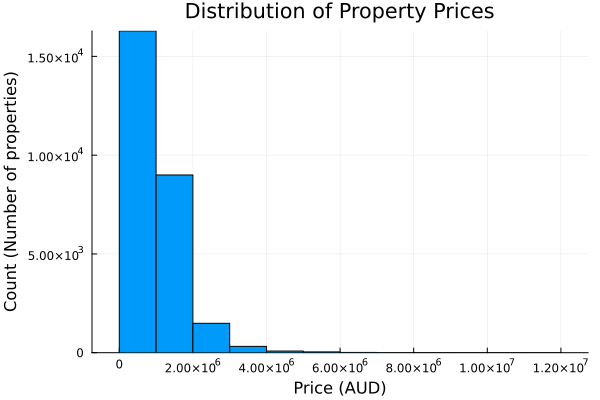

In [51]:
#Histogram of Price Distributions
Plots.histogram(df.Price, bins=20, xlabel="Price (AUD)",
          ylabel="Count (Number of properties)",label = "",
         title="Distribution of Property Prices")

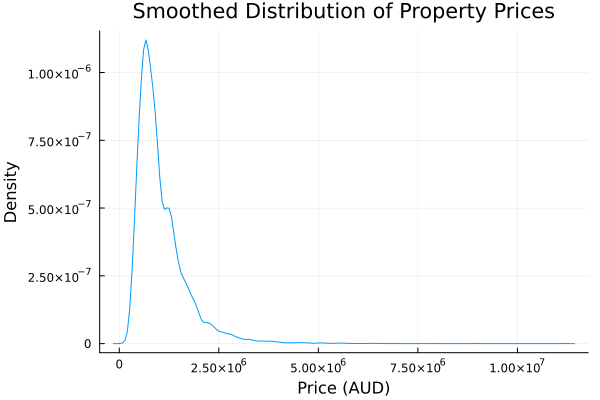

In [101]:
# Smooth histogram (density plot) for property prices
density(skipmissing(df.Price), xlabel="Price (AUD)", ylabel="Density",
        title="Smoothed Distribution of Property Prices", label="")

The  density values on the y-axis  above are are in the magnitude of 10^−6 to 10^−7.

The density plot is designed to show a probability density function (PDF) rather than counts. The y-axis values represent density per unit on the x-axis, meaning that the total area under the curve is 1. The values are so small due to the large range of prices, so even prices that occur more ofthen then others (closer to the 10^6 range) still occur quite infrequently because there are such a large range of prices that the properties are sold for. Since the area under the entire density curve must sum to 1, the values can become very small when the range of the x-axis is large.

Despite the values being quite small and over a large range we can still get an idea of where the majority of prices fall. This being in the 1 - 1.5 million dollar range. Doing statistical analysis will verify this point.

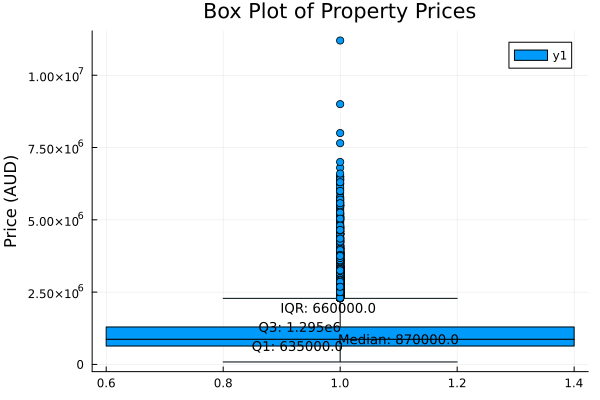

In [140]:

# Calculate the quartiles and IQR
quartiles = quantile(skipmissing(df.Price), [0.25, 0.5, 0.75])
iqr1 = quartiles[3] - quartiles[1]

# Create the box plot
boxplot(skipmissing(df.Price), xlabel="", ylabel="Price (AUD)", 
        title="Box Plot of Property Prices")

# Splitting up qaurtlies for plotting
q1 = quartiles[1]
q2 = quartiles[2]
q3 = quartiles[3]

# Annotate the quartiles and IQR with custom sizes and positions
annotate!(0.85, quartiles[1], text("Q1: $q1", 9, :left))   
annotate!(1.1, quartiles[2], text("Median: $q2", 9, :center)) 
annotate!(1.0, quartiles[3], text("Q3: $q3",9, :right))  
annotate!(0.9, quartiles[3] + iqr1, text("IQR: $iqr1", 9, :left))       

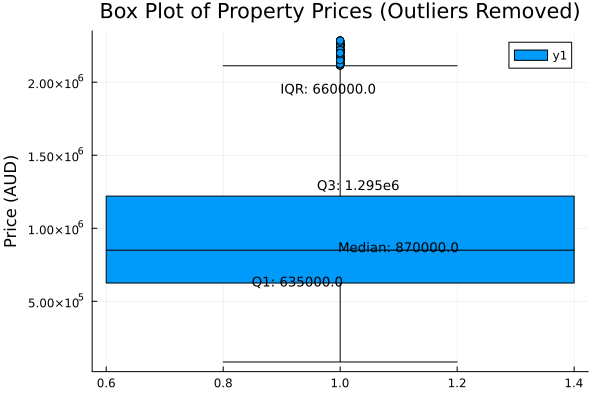

In [141]:


# Remove missing values and create a clean vector of prices
clean_prices = skipmissing(df.Price)

# Calculate the quartiles and IQR
quartiles = quantile(clean_prices, [0.25, 0.5, 0.75])
iqr_value = quartiles[3] - quartiles[1]

# Define lower and upper bounds for outlier removal  - to show the box plot better
lower_bound = quartiles[1] - 1.5 * iqr_value
upper_bound = quartiles[3] + 1.5 * iqr_value

# Filter the Price data to remove outliers
filtered_prices = filter(x -> x >= lower_bound && x <= upper_bound, clean_prices)

# Create the box plot
boxplot(filtered_prices, xlabel="", ylabel="Price (AUD)", 
        title="Box Plot of Property Prices (Outliers Removed)")

# Splitting up quartiles for plotting
q1 = quartiles[1]
q2 = quartiles[2]
q3 = quartiles[3]

# Annotate the quartiles and IQR with custom sizes and positions
annotate!(0.85, q1, text("Q1: $q1", 9, :left))   
annotate!(1.1, q2, text("Median: $q2", 9, :center)) 
annotate!(1.1, q3, text("Q3: $q3", 9, :right))  
annotate!(0.9, q3 + iqr_value, text("IQR: $iqr_value", 9, :left))  

Above is a statsitical insight into what can be obtained from the Price Data in the Dataframe. This boxplot gives a bit better insight and view of what each value in the interquartile range is. We can see that the median house price is $870 000 AUD. With 75% of houses being sold for less than $1,295,000 AUD.  Naturally, there are a large number of outliers whci hcan be seen on the boxplot above, whicha re removed for better viewing in this plot. The outliers drive up the mean and make it a less accurate form of central measure.

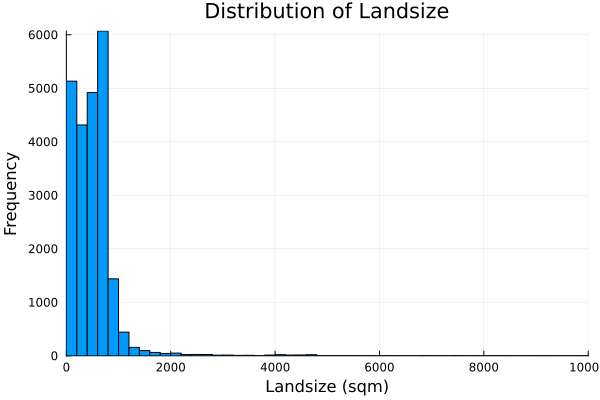

In [127]:
# Skip missing values directly in the plotting functions
histogram(skipmissing(df.Landsize), bins=2000, 
    xlabel="Landsize (sqm)", ylabel="Frequency", 
    title="Distribution of Landsize",
    xlims=(0, 10000), label = "")  # Adjust x-limits as needed

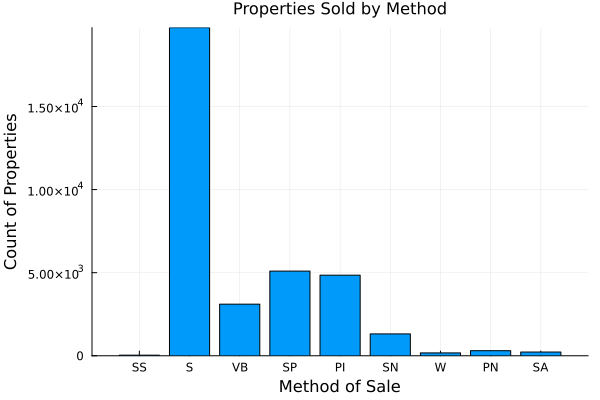

In [74]:
# Count the number of properties sold by method, skipping missing values
method_counts = combine(groupby(df, :Method), nrow => :Count)

# Create the bar plot for the number of properties sold by method
bar(method_counts.Method, method_counts.Count,
    xlabel="Method of Sale", ylabel="Count of Properties", 
    title="Properties Sold by Method",
    titlefontsize=11, legend=false)

Clearly, majority of the properties were sales, with a few small spikes for passed in properties and properties sold prior to an auction.

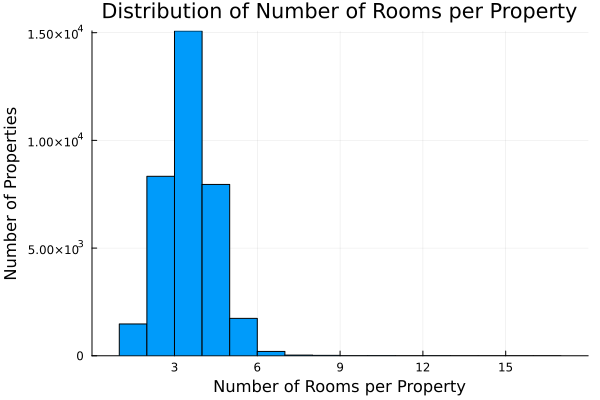

In [86]:
# Rooms plotted
histogram(df.Rooms, xlabel="Number of Rooms per Property",
             ylabel="Number of Properties", bins = 20,
             title="Distribution of Number of Rooms per Property",
             label = "")


The above plot gives a good indication of how many rooms are in each property. A vast majorty have 2,3 and 4 rooms and this is present in the plot. With the vast majority of properties being townhouses and houses. There are a couple of outliers however, we can not be seen clearly on the graph, due to the scale. Some stats are included below to highlight this dominance of 3 bedroom houses in Melbourne.

In [168]:
rooms_data = skipmissing(df.Rooms)
mean_rooms = mean(rooms_data)
median_rooms = median(rooms_data)
mode_rooms = mode(rooms_data)
quartiles = quantile(rooms_data, [0.25, 0.75])
iqr_rooms = quartiles[2] - quartiles[1]  # Interquartile range
std_dev_rooms = std(rooms_data)


# Annotate with statistics
println("Mean: $mean_rooms")
println("Median: $median_rooms")
println("Mode: $mode_rooms")
println("IQR: $iqr_rooms")
println("Std Dev: $std_dev_rooms")


Mean: 3.0310124221820582
Median: 3.0
Mode: 3
IQR: 2.0
Std Dev: 0.9699329348975181


A Standard deviation of around 1, suggests that two-thirds of data points lie within 2-4 bedrooms which is expected from the pplots and what is expected with house sizes in cities.

Below is a section of code which is setp up in order to present the distance for CBD code tor task 2. This section was impelemtned before distance in Task 1, hence it is inculded here, as task 1 was created after it and based off of it.

In [260]:
# Function to convert Distance strings to Float64 and handle errors like "NA" strings.
function clean_distance(distance)
    return try
        parse(Float64, distance)
    catch
        return missing  # Return missing for any parsing issues
    end
end

# Clean the Distance column
plotting_distance = [clean_distance(d) for d in df.Distance if d != "missing"]

# Create a new DataFrame for plotting
# This Dataframe only includes rows with non-missing values for both Distance and Price.
cleaned_df = DataFrame(Distance = plotting_distance, Price = df.Price)

Row,Distance,Price
,Float64?,Int64?
1,2.5,missing
2,2.5,1480000
3,2.5,1035000
4,2.5,missing
5,2.5,1465000
6,2.5,850000
7,2.5,1600000
8,2.5,missing
9,2.5,missing


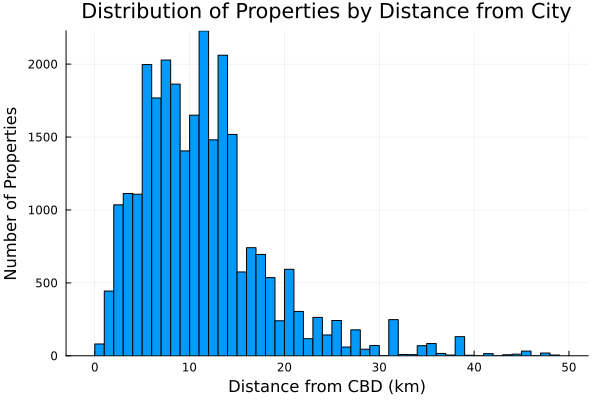

In [149]:
# Create a histogram of the Distance data
histogram(cleaned_df.Distance,
    xlabel = "Distance from CBD (km)", ylabel = "Number of Properties",
    title = "Distribution of Properties by Distance from City",
    bins = 50,  # Adjust the number of bins as needed
    legend = false)

The intetnion of the below segment is to present some statistical analysis of the distances and show where all values are distrubted about the mean.  Statistical values are presented below, but also plotted to show how the values are distributed.

Mean Distance: 11.280276003817063 km
Standard Deviation: 6.787468996334025 km
Min Distance: 0.0 km
Max Distance: 48.1 km


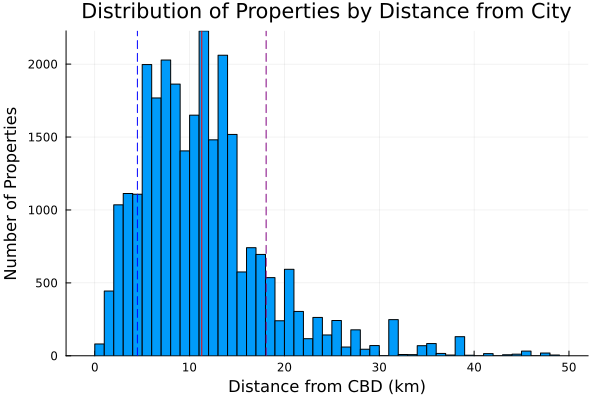

In [171]:
# Calculate stats
mean_distance = mean(cleaned_df.Distance)
std_d = std(cleaned_df.Distance)
min_distance = minimum(cleaned_df.Distance)
max_distance = maximum(cleaned_df.Distance)

# Print stats
println("Mean Distance: $mean_distance km")
println("Standard Deviation: $std_distance km")
println("Min Distance: $min_distance km")
println("Max Distance: $max_distance km")

histogram(cleaned_df.Distance,
    xlabel = "Distance from CBD (km)", ylabel = "No. of Properties",
    title = "Distribution of Properties by Distance from CBD",
    bins = 50,  
    legend = false)

# lines for mean and standard deviation
vline!([mean_distance], label="Mean", color=:red)
vline!([mean_distance + std_d], label="Mean + 1 Std Dev", color=:purple, linestyle=:dash)
vline!([mean_distance - std_d], label="Mean - 1 Std Dev", color=:blue, linestyle=:dash)

## Task 2

Task 2 requries us to plot the Average House Price as a function of the House size (No. of rooms, Landsize, etc.) and the Distance from the city, plus a combination of theses variables. Initially the plots consist of 2 variables with more complex trends plotted after. Some trends that are just of multiple variables are considered as well, for a different perspective. 

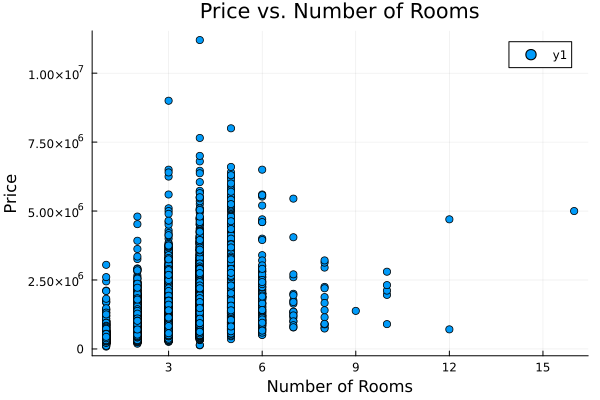

In [8]:

# Scatterplot of The price of Property compared to the number of rooms
scatter(df.Rooms, df.Price, xlabel="Number of Rooms", ylabel="Price", title="Price vs. Number of Rooms")

Clearly a large number of houses are sold with between 1 and 7 bedrooms as expected. These prices vary signifcantly as well, as observed above. Clearly, some houses with upwards of 12 rooms, are sold for less than some with 3 bedrooms. This encourages further investigation into other trends, such as distance to the city and landsize associated with these properties. 

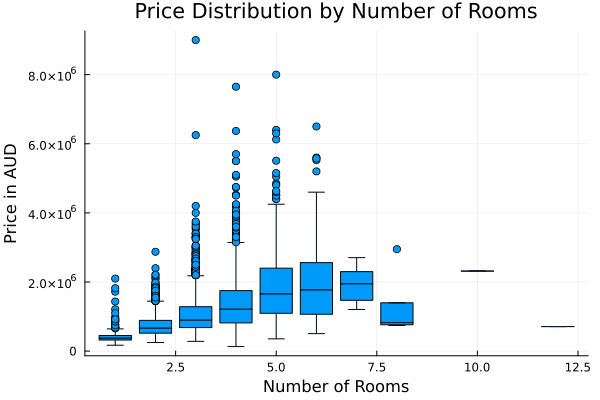

In [190]:
# Remove the missing values for plotting
clean_df = dropmissing(df)
    
# Boxplot of Price by Number of Rooms
@df clean_df boxplot(:Rooms, :Price, xlabel="Number of Rooms",
                      ylabel="Price in AUD", label = "",
                      title="Price Distribution by Number of Rooms")

The following plot allows for some insights. It can be seen that as expected, the average price of property does increase  with the number of rooms in the house. It can be seen that as the room number inncreases from 3 rooms to 7 rooms in a house, the prices close to doubles. A number of outliers are present on the plot as well  - due to the alrge number of data points in the dataframe. 

Below are a number of plots of two variables which show how the price of a propeerty increases with a number of indicators of house size.

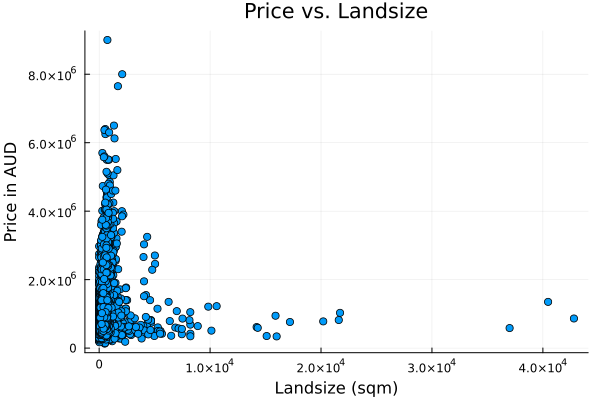

In [195]:
# 1. Scatterplot: Price vs. Landsize
@df clean_df scatter(:Landsize, :Price, label = "", xlabel="Landsize (sqm)", ylabel="Price in AUD", title="Price vs. Landsize")

The following plot does not all for a large number of insights. A statistical analysis will be required to truly assess the trend. Clearly the maximum landsize is around 40000 sqaure metres, and has not attracted a really signifcant price like some of the properties with much less land size. 

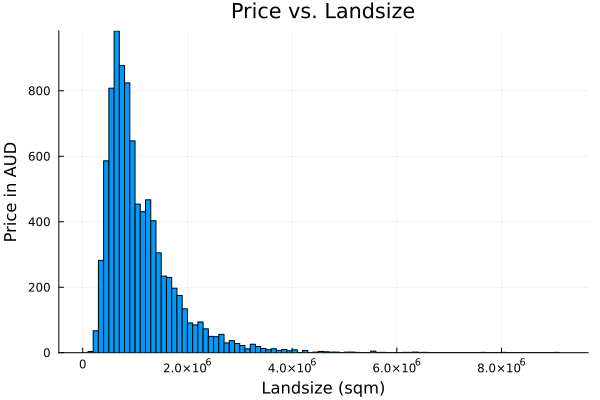

In [194]:
# 1. Histogram Price vs. Landsize
@df clean_df histogram(:Landsize, :Price, label = "", xlabel="Landsize (sqm)", ylabel="Price in AUD", title="Price vs. Landsize")

The plot above shows a semi-normally distrubted plot for landsize. This is intruging as you would believe that properties, particualry in a city are either quite small and surburban or large and out in the more regional areas. Nonetheless,  it can be clearly seen that there are a lot more proerties with less landsize and as a result a greater range of property costs. This has resulted in larger prices for less landsize - a seemingly strange trend.

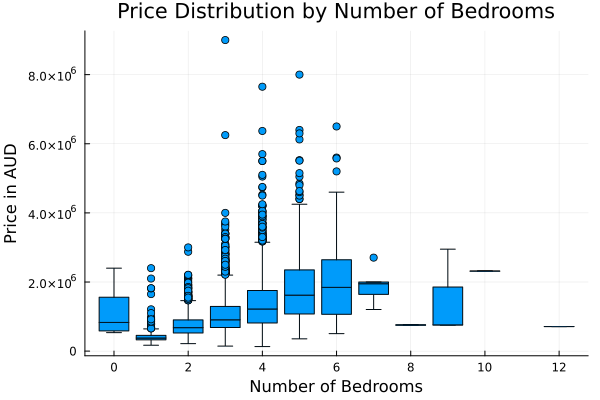

In [188]:
# 2. Boxplot: Price by Number of Bedrooms
@df clean_df boxplot(:Bedroom2, :Price, label = "", xlabel="Number of Bedrooms", ylabel="Price in AUD", title="Price Distribution by Number of Bedrooms")

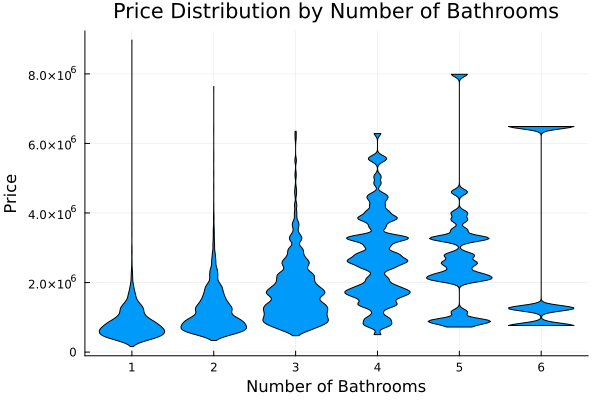

In [317]:
# 3. Violin Plot: Price by Number of Bathrooms
@df clean_df violin(:Bathroom, :Price, label = "",
                    xlabel="Number of Bathrooms",
                    ylabel="Price",
                    title="Price Distribution by Number of Bathrooms")

The above plots, show that with more Bathrooms and bedrooms generally the price of the property does increase. Exceptions do occur however this is the gneral trend. In the plot above, the price varies particuarly for 4, 5 and 6 bedroom places quite substianlly, in small windows. This could be that the more expesnsive groups refer to properties with large amounts of land or are closer to the city. The clumping will be investigated with plots of more variables. 

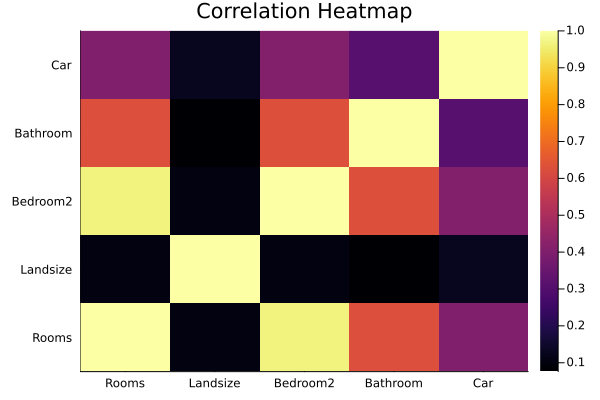

In [197]:
# Assuming clean_df is your DataFrame without missing values and with numeric columns
numeric_df = select(clean_df, [:Rooms, :Landsize, :Bedroom2, :Bathroom, :Car])  # Select only the numeric columns

# Calculate the correlation matrix directly using cor()
corr_matrix = cor(Matrix(numeric_df))

# Plot the heatmap for the correlation matrix
heatmap(corr_matrix, title="Correlation Heatmap", 
        xticks=(1:5, ["Rooms", "Landsize", "Bedroom2", "Bathroom", "Car"]),
        yticks=(1:5, ["Rooms", "Landsize", "Bedroom2", "Bathroom", "Car"]))

To hypothesise the impact that some fot he variables have on each, a heat map has been included. Clearly each variable, has 100% correlation with itself, but it is interesting to note that the number of bedrooms and abthrooms in a house share a correlation, but the number of carports/ car spaces does not relate - as substantially. This would suggest that small properties (with 3/4 bedrooms) still have 1 or 2 car spaces, but may only have 1 bathroom. Additionally, landsize does not appear to have any substantial trend with any of the other variables which indicate house size.

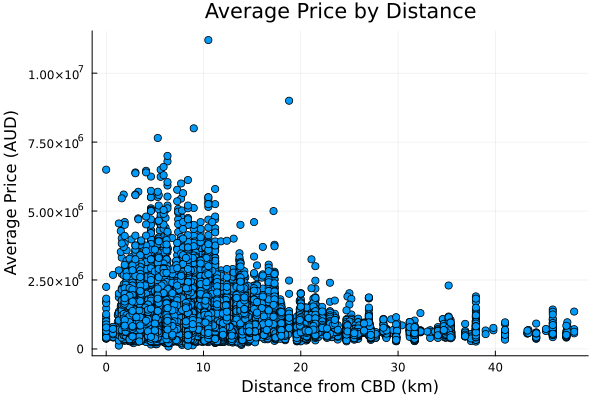

In [201]:
# Create a scatter plot with the average prices by distance
scatter(cleaned_df.Distance, cleaned_df.Price,
    xlabel = "Distance from CBD (km)", ylabel = "Average Price (AUD)", title = "Average Price by Distance",
    legend = false)

There are too many plots in the above, as a result and average has been done across the distances and is shown below for better viewing. 

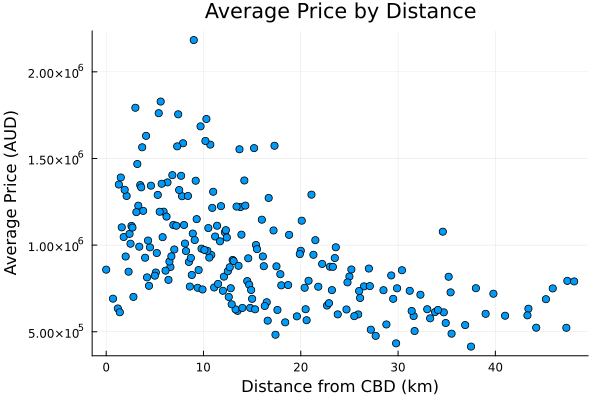

In [202]:
# Group by Distance and calculate the average Price
grouped_df = combine(groupby(cleaned_df, :Distance), :Price => mean => :AvgPrice)

# Create a scatter plot with the average prices by distance
scatter(grouped_df.Distance, grouped_df.AvgPrice,
    xlabel = "Distance from CBD (km)", ylabel = "Average Price (AUD)", title = "Average Price by Distance",
    legend = false)

In the above plot, it can be seen that the the further way from the CBD, the average property price decreases. 

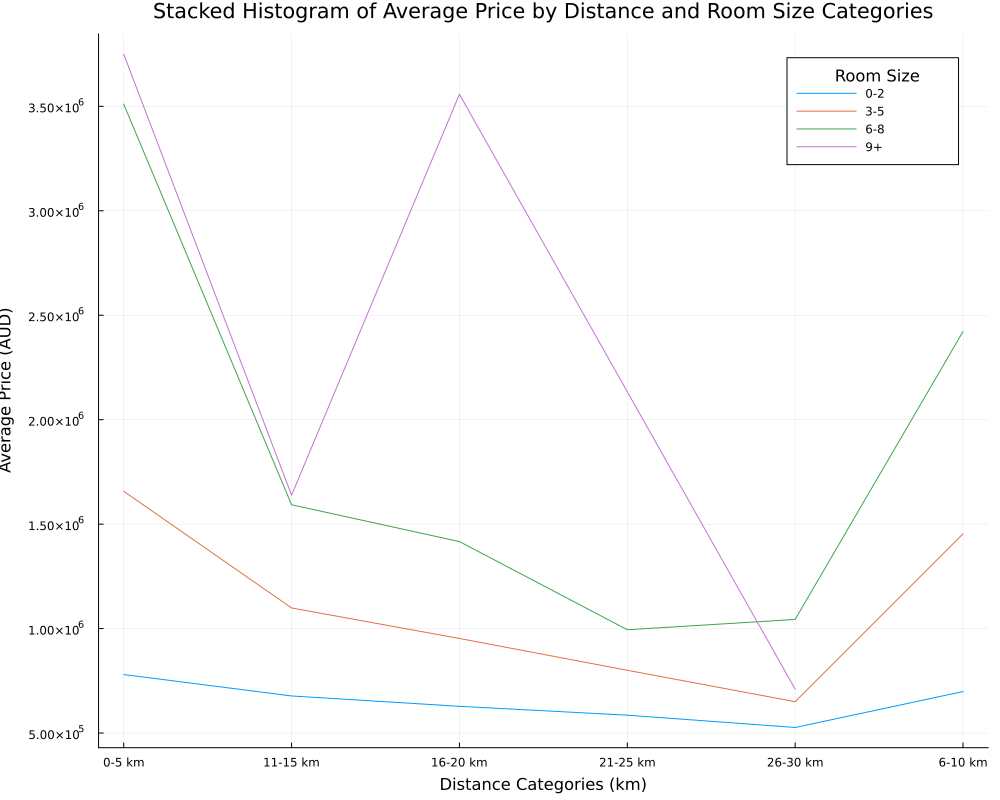

In [280]:
using CategoricalArrays

# Function to convert Distance strings to Float64 and handle errors like "NA" strings.
function clean_distance(distance)
    return try
        parse(Float64, distance)
    catch
        return missing  # Return missing for any parsing issues
    end
end

# Clean the Distance column
plotting_distance = [clean_distance(d) for d in df.Distance if d != "missing"]

# Create a new DataFrame for plotting
# This Dataframe only includes rows with non-missing values for both Distance and Price.
cleaned_df = DataFrame(Distance = plotting_distance, Price = df.Price, Rooms = df.Rooms)
cleaned_df = cleaned_df[.!ismissing.(cleaned_df.Distance) .& .!ismissing.(cleaned_df.Price), :]

# Step 1: Manually categorize Rooms into ranges
cleaned_df.RoomSizeCat = CategoricalArray(map(rooms -> 
    rooms <= 2 ? "0-2" :
    rooms <= 5 ? "3-5" :
    rooms <= 8 ? "6-8" :
    "9+",  # Assuming any value above 8 falls into this category
    cleaned_df.Rooms))

# Step 2: Manually categorize Distance into bins
cleaned_df.DistanceCat = CategoricalArray(map(distance -> 
    distance <= 5 ? "0-5 km" :
    distance <= 10 ? "6-10 km" :
    distance <= 15 ? "11-15 km" :
    distance <= 20 ? "16-20 km" :
    distance <= 25 ? "21-25 km" :
    "26-30 km",  # Assuming any value above 30 falls into this category
    cleaned_df.Distance))

# Step 3: Group by Distance categories and Room Size categories, calculate the average Price
grouped_df = combine(groupby(cleaned_df, [:DistanceCat, :RoomSizeCat]), :Price => mean => :AvgPrice)

# Step 4: Create a stacked histogram of Average Price by Distance Categories and Room Size Categories
@df grouped_df plot(:DistanceCat, :AvgPrice, 
    group = :RoomSizeCat,
    xlabel = "Distance Categories (km)", ylabel = "Average Price (AUD)", 
    title = "Stacked Histogram of Average Price by Distance and Room Size Categories", 
    legend = true, legendtitle = "Room Size", titlesize = 12,
    stacked = true, size=(1000, 800))


Due to the vast array of values, possible for cost and distance from the city, in order to present meaningful plots, the distance from the city has been split into discrete groups and reduced with a maximum of 30km from the city. Trends can now be observed in the following plot comapring three variables. Clearly, properties with nine rooms or more possess quite varying costs across each distance from the city, due to some distance categories not having amny properties in this range. Additionally, properties with so many rooms vary in Landsize and subrub and as a result so does their price. That being said, we can observe that these properties generally are more expensive. So based of this data above, properties with more rooms are more expensize. Additioanlly, properties that are closer to the city are also more expesnive up until 26-30km from the city then other variables become more important which drives the price back up. 

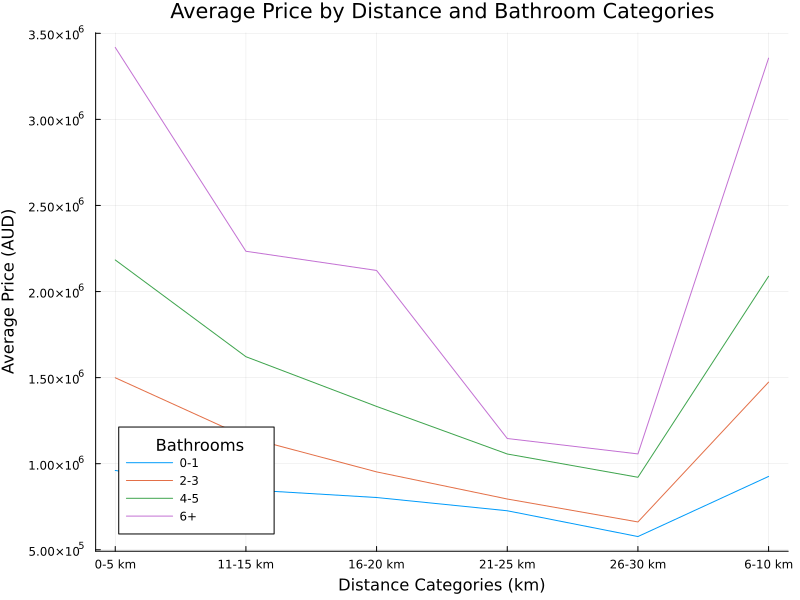

In [284]:
#Using a very similar process - the below allows for the plotting of Avergae price for distance from the
# city comparing the number of bathrooms.
cleaned_df = DataFrame(Distance = plotting_distance, Price = df.Price, Bathrooms = df.Bathroom)
cleaned_df = cleaned_df[.!ismissing.(cleaned_df.Distance) .& .!ismissing.(cleaned_df.Price) .& .!ismissing.(cleaned_df.Bathrooms), :]

# Manually categorize Bathrooms into ranges
cleaned_df.BathroomSizeCat = CategoricalArray(map(bathrooms -> 
    bathrooms <= 1 ? "0-1" :
    bathrooms <= 2 ? "2-3" :
    bathrooms <= 3 ? "4-5" :
    "6+",  # Assuming any value above 5 falls into this category
    cleaned_df.Bathrooms))

# Manually categorize Distance into bins
cleaned_df.DistanceCat = CategoricalArray(map(distance -> 
    distance <= 5 ? "0-5 km" :
    distance <= 10 ? "6-10 km" :
    distance <= 15 ? "11-15 km" :
    distance <= 20 ? "16-20 km" :
    distance <= 25 ? "21-25 km" :
    "26-30 km",  # Assuming any value above 30 falls into this category
    cleaned_df.Distance))

#  Distance categories and Bathroom categories, calculate the average Price
grouped_df = combine(groupby(cleaned_df, [:DistanceCat, :BathroomSizeCat]), :Price => mean => :AvgPrice)

@df grouped_df plot(:DistanceCat, :AvgPrice, 
    group = :BathroomSizeCat,
    xlabel = "Distance Categories (km)", ylabel = "Average Price (AUD)", 
    title = "Average Price by Distance and Bathroom Categories", 
    legend = true, legendtitle = "Bathrooms", 
    size=(800, 600))

Similar to the above trend, the number of bathrooms do indicate a larger purchase price as expected. However, the difference between price does decrease for properties around 21-30km from the city. For properties further than this way, prices do increase with the number of bathrooms - possessing a smilar trend to the number of rooms. It suggests that the same trend would occur for the number of carports. uncertainty however, is introduced due to the introduction of distance as a discrete variable, however, the expected trends are observed - their  exact values however, might vary from the observed. 

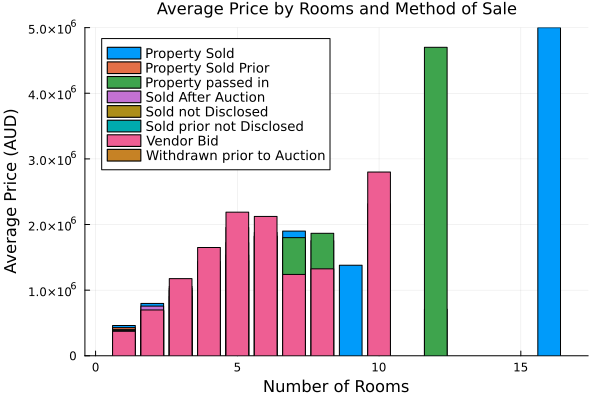

In [53]:
# Group the data and calculate average price, skipping missing values
rooms_methods_df = combine(groupby(df, [:Rooms, :Method]), 
                     :Price => (x -> mean(skipmissing(x))) => :AvgPrice)

# Maps the abbreviated method names to full names
full_method_names = [method_mapping[m] for m in rooms_methods_df.Method]

# Creates the bar plot
Plots.bar(rooms_methods_df.Rooms, rooms_methods_df.AvgPrice, group=full_method_names, 
    xlabel="Number of Rooms", ylabel="Average Price (AUD)", 
    title="Average Price by Rooms and Method of Sale",
    titlefontsize=11, legend=:topleft, legendfontsize=9)

## Task 3

The below two plots highlight the volume of sales over each month in the DataFrame. They highlight how many properties were sold each month and the total transaction value that each of these properties sum to over the month.

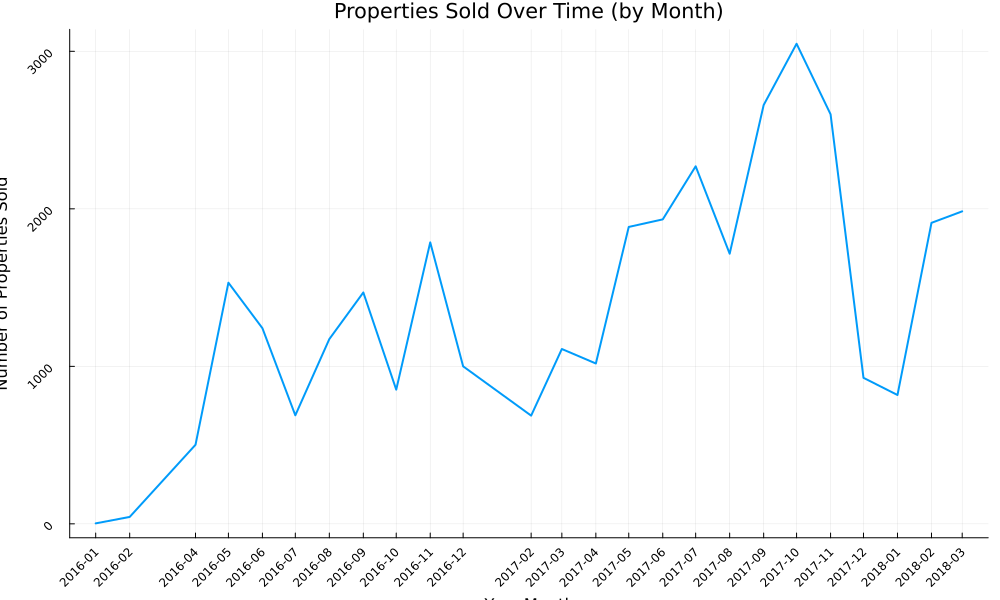

In [247]:

# function to parse strings into Dates and handle missings and "N/A" items.
function clean_date(date_str::String15)
    try
        return Date(date_str, "dd/mm/yyyy") 
    catch
        return missing  # Return missing if there is an issue
    end
end

# Convert the list of date strings to actual Date objects for plotting
parsed_dates = [clean_date(date_str) for date_str in df.Date]

# Creates a DataFrame for plotting.
dates_frame = DataFrame(Date = parsed_dates)

# Remove rows with missing dates
dates_frame = dates_frame[.!ismissing.(dates_frame.Date), :]

# Extract Year-Month as Date (using the 1st of the month)
dates_frame.YearMonth = [Date(Dates.year(d), Dates.month(d), 1) for d in dates_frame.Date]

# Group by YearMonth and count the number of sales.
sales_by_month_df = combine(groupby(dates_frame, :YearMonth), nrow => :SalesCount)

# Plot the number of sales over time (Months)
Plots.plot(sales_by_month_df.YearMonth, sales_by_month_df.SalesCount, 
    seriestype = :line,  # Line plot for time series data
    xlabel="Year-Month", ylabel="Number of Properties Sold", 
    title="Properties Sold Over Time (by Month)", 
    legend=false, size=(1000, 600), lw=2, rotation=45,
    xticks=(sales_by_month_df.YearMonth, 
             Dates.format.(sales_by_month_df.YearMonth, "yyyy-mm"))) 

The above plot shows how sales have been increasing over time, from January 2016 to March 2018. Sales were seasonally which is shown in the troughs and peaks across the plots. There appear to be large spikes in the number of proerties sold in Spring. With a large drop over the Christmas- New Year period every year.

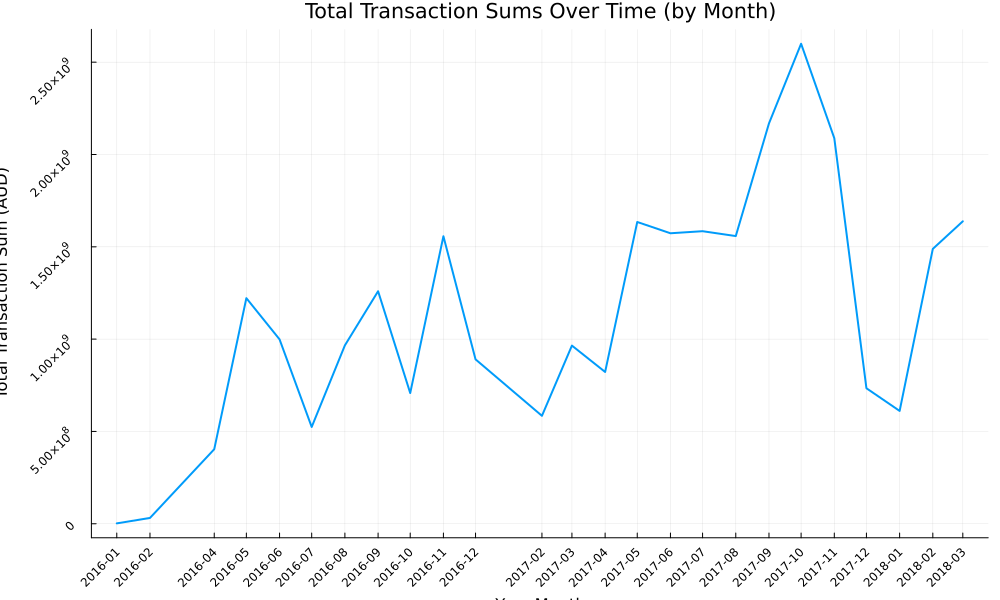

In [84]:

# Step 3: Create a DataFrame for further processing, without effecting the original.
dates_frame = DataFrame(Date = parsed_dates, Price = df.Price)

# Removes rows with missing values 
dates_frame = dates_frame[.!ismissing.(dates_frame.Date) .& .!ismissing.(dates_frame.Price), :]


# Extract Year-Month as Date (using the 1st of the month)
dates_frame.YearMonth = [Date(Dates.year(d), Dates.month(d), 1) for d in dates_frame.Date]

#  Group by YearMonth and sum the prices
transaction_sum_df = combine(groupby(dates_frame, :YearMonth), 
                              :Price => sum => :TotalTransactionSum)

#Plot the total transaction sums over time (Months)
Plots.plot(transaction_sum_df.YearMonth, transaction_sum_df.TotalTransactionSum, 
    seriestype = :line,  # Line plot for time series data
    xlabel="Year-Month", ylabel="Total Transaction Sum (AUD)", 
    title="Total Transaction Sums Over Time (by Month)", 
    legend=false, size=(1000, 600), lw=2, rotation=45,
    xticks=(transaction_sum_df.YearMonth, 
             Dates.format.(transaction_sum_df.YearMonth, "yyyy-mm")))

The above plot shows the total transaction values across each month for the sales in that month. As expected, it presents quite a similar trend to the above plot, however there are some differences. Around June through to August in 2017 - the transaction values remain quite stable, however, a  small spike in the number of properties sold is observed in the plot above. This suggests a lot of cheaper properties were sold in this period - particulary in July - to reduce the total transaction value for the month but show increased property sales. Apart from this, both graphs are quite consistent. 

Next, A plot for how many of each type of property were sold each month is required. The following segments sets up all the plots and then the next segments plot all of them.

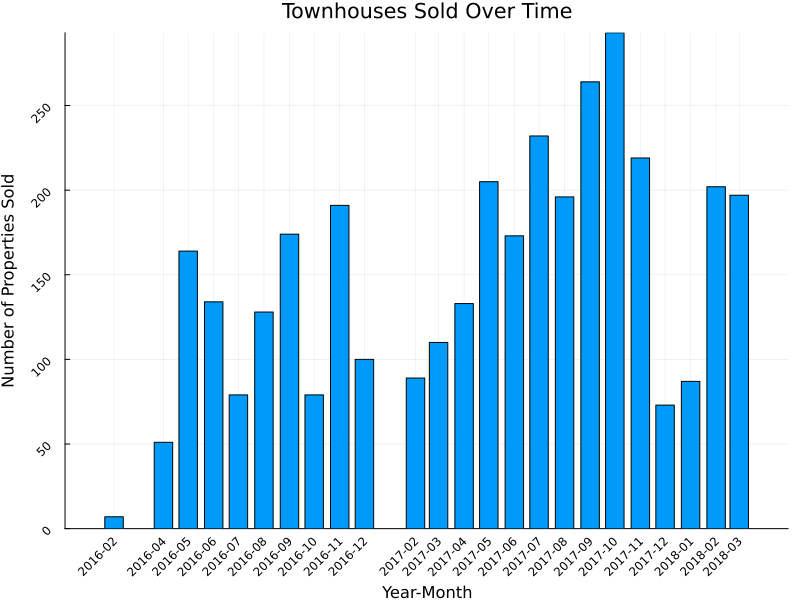

In [217]:

# Convert the list of date strings to actual Date objects for plotting
parsed_dates = [clean_date(date_str) for date_str in df.Date]

# Create a DataFrame for plotting with Date and Type
dates_frame = DataFrame(Date = parsed_dates, Type = df.Type)

# Remove rows with missing dates
dates_frame = dates_frame[.!ismissing.(dates_frame.Date) .& .!ismissing.(dates_frame.Type), :]

#  Extract Year-Month as Date (using the 1st of the month)
dates_frame.YearMonth = [Date(Dates.year(d), Dates.month(d), 1) for d in dates_frame.Date]
sales_by_month_type_df = combine(groupby(dates_frame, [:YearMonth, :Type]), nrow => :SalesCount)

# Maps the abbreviated method names to full names
type_mapping = Dict("t" => "Townhouse", "h" => "House", "u" => "Unit")
full_property_type_names = [type_mapping[k] for k in sales_by_month_type_df.Type]

# Adds the full property type names to the DataFrame
sales_by_month_type_df[!, :FullTypeName] = full_property_type_names
townhouse_df = sales_by_month_type_df[sales_by_month_type_df.FullTypeName .== "Townhouse", :]

# Plot for Townhouse
 Plots.bar(townhouse_df.YearMonth, townhouse_df.SalesCount,
           xlabel="Year-Month", ylabel="Number of Properties Sold", 
           title="Townhouses Sold Over Time", 
           legend=false, size=(800, 600), rotation=45,
           xticks=(townhouse_df.YearMonth, Dates.format.(townhouse_df.YearMonth, "yyyy-mm")))


In the above plot we can see that sales peak aroundseptember through November as expected. For Townhouses the maximum sales peak at just below 300 in October of 2017, with no data recorded in the Summer of 2017. Very few were sold in Feburary of 2016 as well.

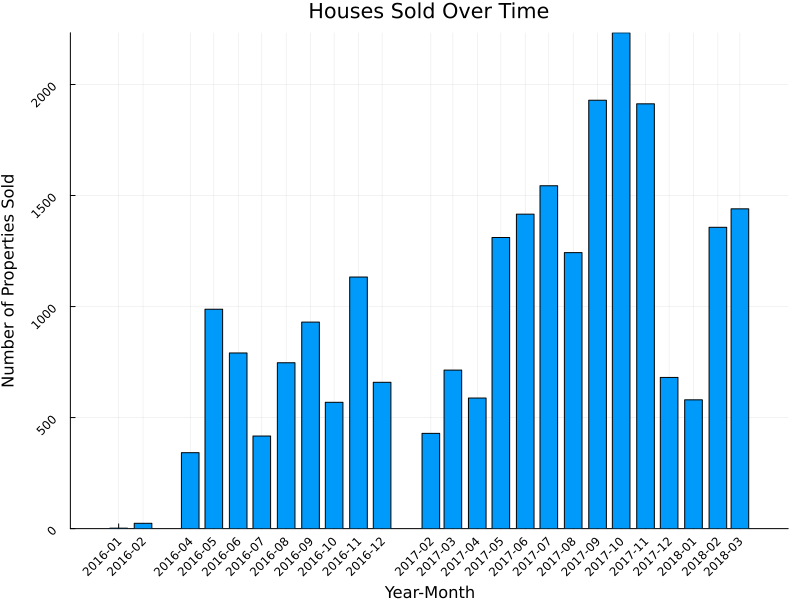

In [228]:
# Set up House dataframe for Plotting
house_df = sales_by_month_type_df[sales_by_month_type_df.FullTypeName .== "House", :]

Plot for House
Plots.bar(house_df.YearMonth, house_df.SalesCount,
          xlabel="Year-Month", ylabel="Number of Properties Sold", 
          title="Houses Sold Over Time", 
          legend=false, size=(800, 600), rotation=45,
          xticks=(house_df.YearMonth, Dates.format.(house_df.YearMonth, "yyyy-mm")))




In the above plot, we can see that sales peak around September through November as expected. For Townhouses the maximum sales peak at just below ~2300 in October of 2017, with no data recorded in the Summer of 2017. Very few were sold in Feburary of 2016 as well - due to a lack of recorded values most likely. A lot more Houses are sold than Townhouses above, due to the increased number of houses existing. Also, the plot hightlights like the one above and below, that the number of properties sold is increasing over time. With more properties sold in January in 2018, then in January of the previous two years. So the market is still seasonal, but  sales are increasing in each season.

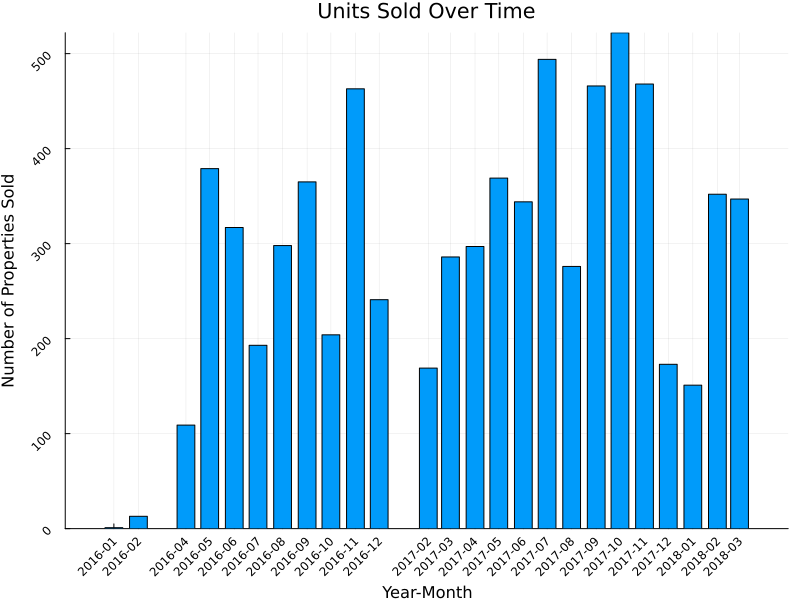

In [229]:
# Set up Unit dataframe for Plotting
unit_df = sales_by_month_type_df[sales_by_month_type_df.FullTypeName .== "Unit", :]

# Plot for Unit
Plots.bar(unit_df.YearMonth, unit_df.SalesCount,
          xlabel="Year-Month", ylabel="Number of Properties Sold", 
          title="Units Sold Over Time", 
          legend=false, size=(800, 600), rotation=45,
          xticks=(unit_df.YearMonth, Dates.format.(unit_df.YearMonth, "yyyy-mm")))

A multitude of Plots can be made for trends over time. In terms of the Regionname column we can check which regions have the most proerties sold. After a bit of analysis on the Keggle page it can be said that the Northern metropolitan and Southern Metropolitan Regions have made up approximately 50% of the Sale for the 3 year period. Instead of doing analysis on all regions, of whichthere are a large number - bar graphs will be shown of these plots. 

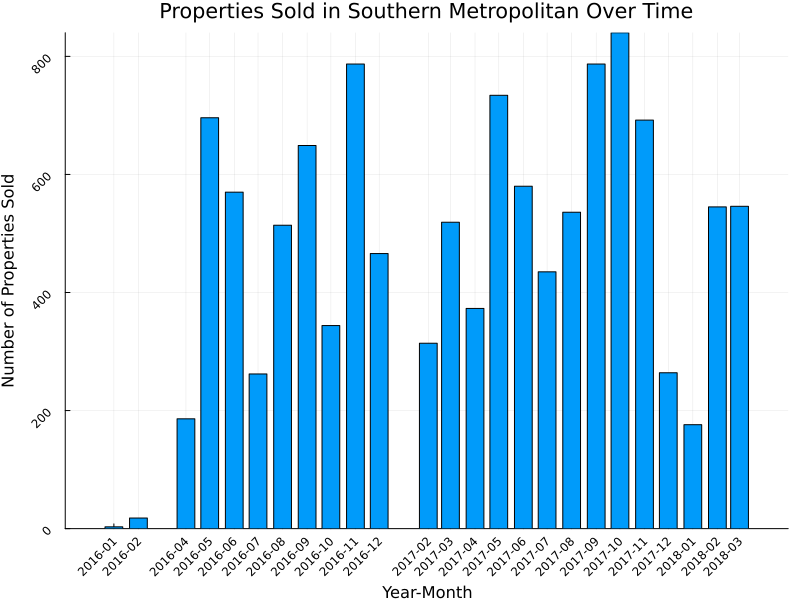

In [252]:
# Create a DataFrame for plotting with Date and Regionname
dates_frame = DataFrame(Date = parsed_dates, Regionname = df.Regionname)

# Remove rows with missing dates or region names
dates_frame = dates_frame[.!ismissing.(dates_frame.Date) .& .!ismissing.(dates_frame.Regionname), :]

# Extract Year-Month as Date (using the 1st of the month)
dates_frame.YearMonth = [Date(Dates.year(d), Dates.month(d), 1) for d in dates_frame.Date]

# Southern Metropolitan region
southern_df = dates_frame[dates_frame.Regionname .== "Southern Metropolitan", :]

# Group by YearMonth and count the number of sales
sales_by_month_southern_df = combine(groupby(southern_df, :YearMonth), nrow => :SalesCount)

# Plot for Southern Metropolitan region
Plots.bar(sales_by_month_southern_df.YearMonth, sales_by_month_southern_df.SalesCount,
           xlabel="Year-Month", ylabel="Number of Properties Sold", 
           title="Properties Sold in Southern Metropolitan Over Time", 
           legend=false, size=(800, 600), rotation=45,
           xticks=(sales_by_month_southern_df.YearMonth, 
                    Dates.format.(sales_by_month_southern_df.YearMonth, "yyyy-mm")))

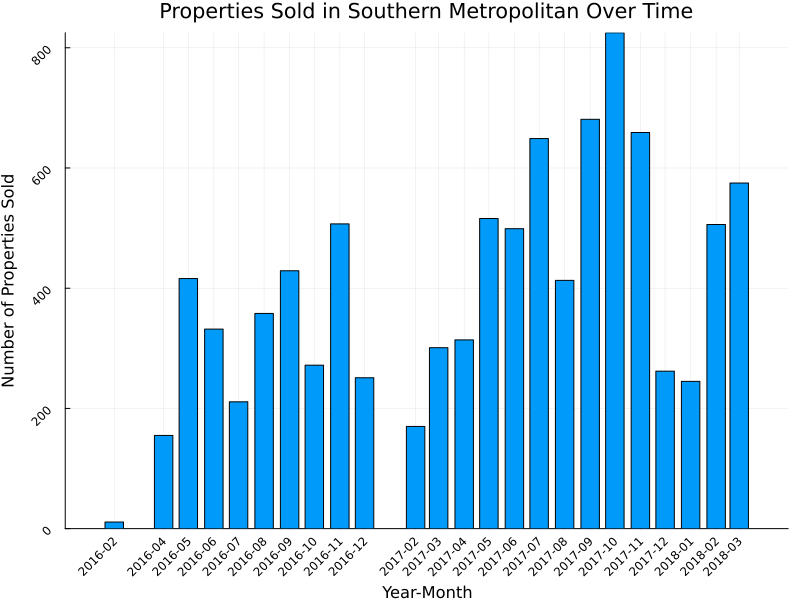

In [258]:
#  Northern Metropolitan region
northern_df = dates_frame[dates_frame.Regionname .== "Northern Metropolitan", :]

#  Group by YearMonth and count the number of sales
sales_by_month_northern_df = combine(groupby(northern_df, :YearMonth), nrow => :SalesCount)

# Plot Northern Metropolitan region
Plots.bar(sales_by_month_northern_df.YearMonth, sales_by_month_northern_df.SalesCount,
           xlabel="Year-Month", ylabel="Number of Properties Sold", 
           title="Properties Sold in Southern Metropolitan Over Time", 
           legend=false, size=(800, 600), rotation=45, bins = 100,
           xticks=(sales_by_month_northern_df.YearMonth, 
                    Dates.format.(sales_by_month_northern_df.YearMonth, "yyyy-mm")))

Unsurprisingly, the trends of property sales map very closely to the overall sales trends. Both the Northern and Southern metropolitan Regions are quite similar and highlight all previous trends found in the data - reinforcing them.

## Task 4

Now required to use the concepts from task 2 and plots to form linear regression models for predicting house prices.

Simple Linear Regression Model Summary:
StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, LinearAlgebra.CholeskyPivoted{Float64, Matrix{Float64}, Vector{Int64}}}}, Matrix{Float64}}

AvgPrice ~ 1 + Distance

Coefficients:
───────────────────────────────────────────────────────────────────────────────────────
                      Coef.  Std. Error      t  Pr(>|t|)      Lower 95%       Upper 95%
───────────────────────────────────────────────────────────────────────────────────────
(Intercept)       1.19434e6     31571.2  37.83    <1e-95       1.1321e6       1.25657e6
Distance     -15295.8            1596.8  -9.58    <1e-17  -18443.5       -12148.0
───────────────────────────────────────────────────────────────────────────────────────

Model Coefficients and p-values:
[1.1943386796140545e6, -15295.760839499419]
P-values:[5.6991368982994436e-96, 2.820380618075498e-18]


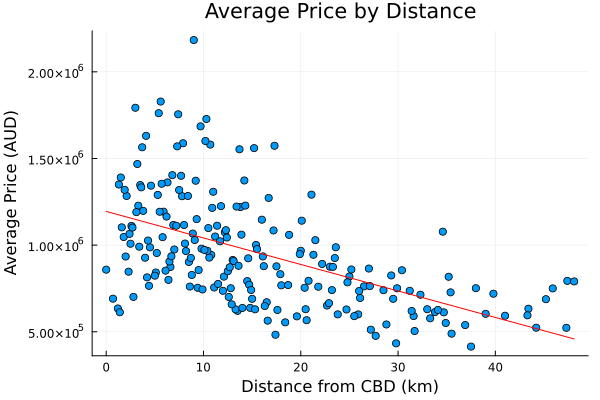

In [278]:

# Fit a simple linear regression model
simple_model = lm(@formula(AvgPrice ~ Distance), grouped_df)

# Display the model summary
println("Simple Linear Regression Model Summary:")
println(simple_model)

# Extract the p-values - recommendation found on the Julia page.
coeff_table = coeftable(simple_model)
p_values = coeff_table.cols[4]

# Assess the quality of the models using p-values
println("\nModel Coefficients and p-values:")
println(coef(simple_model), "\nP-values:", p_values)

# Step 4: Plotting the scatter plot with the regression lines
# Create a scatter plot with the average prices by distance
Plots.scatter(grouped_df.Distance, grouped_df.AvgPrice,
    xlabel = "Distance from CBD (km)", ylabel = "Average Price (AUD)", title = "Average Price by Distance",
    legend = false)
plot!(grouped_df.Distance, predict(simple_model, grouped_df), color=:red, label="Linear Fit")


This code produces a linear regression model for all properties, however, the task just asks for House price recommendations, as a result the House Type will only be included in the next plot.

Simple Linear Regression Model Summary:
StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, LinearAlgebra.CholeskyPivoted{Float64, Matrix{Float64}, Vector{Int64}}}}, Matrix{Float64}}

AvgPrice ~ 1 + Distance

Coefficients:
─────────────────────────────────────────────────────────────────────────────────────────
                      Coef.  Std. Error       t  Pr(>|t|)       Lower 95%       Upper 95%
─────────────────────────────────────────────────────────────────────────────────────────
(Intercept)       1.59295e6    45753.2    34.82    <1e-87       1.50275e6       1.68315e6
Distance     -28570.3           2297.78  -12.43    <1e-26  -33100.2        -24040.4
─────────────────────────────────────────────────────────────────────────────────────────

Model Coefficients and p-values:
[1.592951268332776e6, -28570.26897822147]
P-values:[1.0275017397556577e-88, 6.648203785669744e-27]


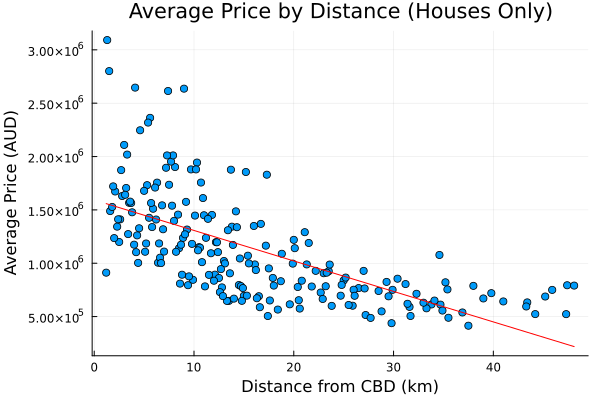

In [285]:

# Filter the DataFrame for houses only (Type "h")
houses_df = df[df.Type .== "h", :]

# Clean the Distance column for the filtered houses
plotting_distance = [clean_distance(d) for d in houses_df.Distance if d != "missing"]

# Create a new DataFrame for plotting with only houses
# This DataFrame only includes rows with non-missing values for both Distance and Price.
cleaned_df = DataFrame(Distance = plotting_distance, Price = houses_df.Price)
cleaned_df = cleaned_df[.!ismissing.(cleaned_df.Distance) .& .!ismissing.(cleaned_df.Price), :]

# Group by Distance and calculate the average Price for houses
grouped_df = combine(groupby(cleaned_df, :Distance), :Price => mean => :AvgPrice)

# Fit a simple linear regression model
simple_model = lm(@formula(AvgPrice ~ Distance), grouped_df)

# Display the model summary
println("Simple Linear Regression Model Summary:")
println(simple_model)

# Extract the p-values
coeff_table = coeftable(simple_model)
p_values = coeff_table.cols[4]

# Assess the quality of the models using p-values
println("\nModel Coefficients and p-values:")
println(coef(simple_model), "\nP-values:", p_values)

# Step 4: Plotting the scatter plot with the regression lines
# Create a scatter plot with the average prices by distance
Plots.scatter(grouped_df.Distance, grouped_df.AvgPrice,
    xlabel = "Distance from CBD (km)", ylabel = "Average Price (AUD)", 
    title = "Average Price by Distance (Houses Only)", legend = false)

# Add the linear regression line
plot!(grouped_df.Distance, predict(simple_model, grouped_df), color=:red, label="Linear Fit")

As observed above we have a linear regression model for House Prices, which describes the average price at all distances between 0 and 50km from the CBD. The model is linear and the data is not correlated this way and as a result the model isn't very accurate. Reading off the p-value. The p-value is much less that 0.05 or 0.001 and as a result, there is clearly a statistically signanct trend, and the Average proeprty price depends on the distance from the Melbourne CBD. With model y ~ -28570.27x + 1.593 * 10^6 ,  where y is the Average price of a property, and x is the distance from the CBD.

Simple Linear Regression Model Summary:
StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, LinearAlgebra.CholeskyPivoted{Float64, Matrix{Float64}, Vector{Int64}}}}, Matrix{Float64}}

AvgPrice ~ 1 + Landsize

Coefficients:
──────────────────────────────────────────────────────────────────────────
                Coef.   Std. Error      t  Pr(>|t|)   Lower 95%  Upper 95%
──────────────────────────────────────────────────────────────────────────
(Intercept)  1.3984e6  21498.3      65.05    <1e-99   1.35623e6  1.44058e6
Landsize     2.14461       1.55612   1.38    0.1684  -0.908213   5.19743
──────────────────────────────────────────────────────────────────────────

Model Coefficients and p-values:
[1.3984046431438858e6, 2.144609716557501]
P-values:[0.0, 0.16838852284878728]


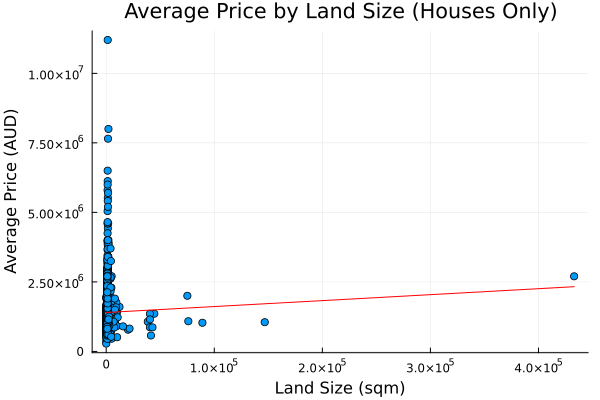

In [342]:

# Create a new DataFrame for plotting with only houses
cleaned_df = houses_df[.!ismissing.(houses_df.Landsize) .& .!ismissing.(houses_df.Price), :]

# Group by Landsize and calculate the average Price for houses
grouped_df = combine(groupby(cleaned_df, :Landsize), :Price => mean => :AvgPrice)

# Fit a LRM
simple_model = lm(@formula(AvgPrice ~ Landsize), grouped_df)

# Display 
println("Simple Linear Regression Model Summary:")
println(simple_model)

# p-values
coeff_table = coeftable(simple_model)
p_values = coeff_table.cols[4]

# Assess the quality 
println("\nModel Coefficients and p-values:")
println(coef(simple_model), "\nP-values:", p_values)


# Create a scatter plot with the average prices by land size
Plots.scatter(grouped_df.Landsize, grouped_df.AvgPrice,
    xlabel = "Land Size (sqm)", ylabel = "Average Price (AUD)", 
    title = "Average Price by Land Size (Houses Only)",
    size(800,600), legend = false)

# Add the LR line
plot!(grouped_df.Landsize, predict(simple_model, grouped_df), color=:red, label="Linear Fit")

Observing this plot, we do not get much sinight as majroity of the values are so close to 0, so we apply x- limits and observe.

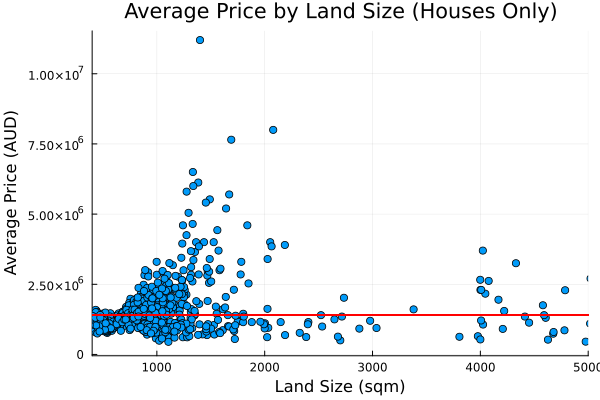

In [334]:
# Create a scatter plot
Plots.scatter(grouped_df.Landsize, grouped_df.AvgPrice,
    xlabel = "Land Size (sqm)", ylabel = "Average Price (AUD)", 
    title = "Average Price by Land Size (Houses Only)",
    xlims=(400, 5000), size(800,600), legend = false)
plot!(grouped_df.Landsize, predict(simple_model, grouped_df), color=:red, label="Linear Fit")

As you can see above, the trend is that there is no great method of predicting the price based off of the landsize shown. Clearly houses with more space, do not mean more expensive properties. However, this does not account for properties with the same number of Rooms and different Landsize, or the same suburb and different Landsize. However, Landsize as a stand alone variable cannot not indicate a property's value. This is further backed up by a p-value of > 0.05 - we cannot suggest that there is a pattern between Price and Landsize.

A similar proces has been undertaken for the No. of Rooms below. To show an averaged plot and inorder to reduce the sheer number of plots. An Avergae has been taken across all numbers of Rooms. This has dramatically reduced the number of plots. The code is based of the others above, and gives an indication of whether the Number of Rooms has an effect on the cost of property. 

Simple Linear Regression Model Summary:
StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64

}}, GLM.DensePredChol{Float64, LinearAlgebra.CholeskyPivoted{Float64, Matrix{Float64}, Vector{Int64}}}}, Matrix{Float64}}

AvgPrice ~ 1 + Rooms

Coefficients:
────────────────────────────────────────────────────────────────────────────
                 Coef.     Std. Error     t  Pr(>|t|)   Lower 95%  Upper 95%
────────────────────────────────────────────────────────────────────────────
(Intercept)  3.35826e5      3.15103e5  1.07    0.3116  -3.66267e5  1.03792e6
Rooms        2.21846e5  38959.0        5.69    0.0002   1.3504e5   3.08652e5
────────────────────────────────────────────────────────────────────────────
[335825.7947496138, 221846.33831329033]
P-values:[0.0, 0.16838852284878728]


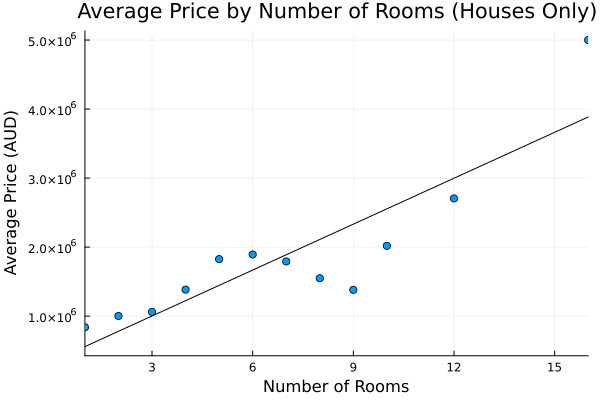

In [343]:
# Remove rows where Rooms or Price is missing
cleaned_df = houses_df[.!ismissing.(houses_df.Rooms) .& .!ismissing.(houses_df.Price), :]

# Group by Rooms and calculate the average Price for houses
grouped_df = combine(groupby(cleaned_df, :Rooms), :Price => mean => :AvgPrice)

# Fit a simple linear regression model
simple_model = lm(@formula(AvgPrice ~ Rooms), grouped_df)

# Display the model summary
println("Simple Linear Regression Model Summary:")
println(simple_model)

# Extract the p-values as above.
println(coef(simple_model), "\nP-values:", p_values)

# Create a scatter plot with the average prices by number of rooms
Plots.scatter(grouped_df.Rooms, grouped_df.AvgPrice,
    xlabel = "Number of Rooms", ylabel = "Average Price (AUD)", 
    title = "Average Price by Number of Rooms (Houses Only)", legend = false, xlims=(minimum(grouped_df.Rooms), maximum(grouped_df.Rooms)))

# Add the linear regression line
plot!(grouped_df.Rooms, predict(simple_model, grouped_df), color=:black, label="Linear Fit")

Reading off the Plot, and considering the obtained p-value (p<0.001), it is clear that there is a statistically signficant relationship between the Number of Rooms in a Property and thr Average Price of a Property. With relationship: y ~ 221846.34x + 335825.795, where y is the Average property price and x is the No. of Rooms. 